## Make Augmented Patches

In this notebook we use an augmentation strategy to create the patches.  We randomly crop patches from the label images, then augment (flip, rotate, rescale) them.

The augmentation could be done 'lazily' via a Pytorch 'Dataset' or as an option when training Stardist.  However in this case we explicitly save all the augmented patches so we can use them in multiple deep learning frameworks. 


## Load the image and previous segmentations

(512, 512)


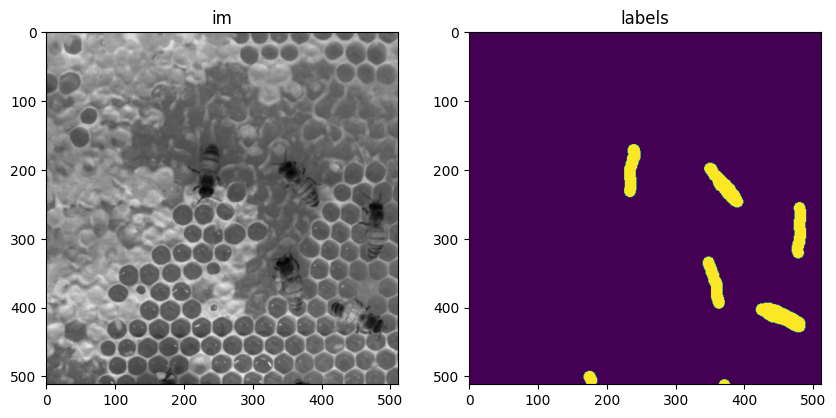

In [1]:
from skimage.io import imread, imsave
import napari
from tnia.deeplearning.dl_helper import make_patch_directory
from tnia.deeplearning.dl_helper import generate_patch_names
import os
from pathlib import Path
from tnia.plotting.plt_helper import imshow_multi2d
import numpy as np
import albumentations as A
import json

#parent_path=Path(r'../../data/roots')
#ext = '.jpg'

parent_path=Path(r'../../data/bees')
ext = '.tif'

label_path = Path(parent_path / r'labels')
image_path = Path(label_path / r'images')
mask_path = Path(label_path / r'masks')

files = list(image_path.glob('*'+ext))
index = 0
splitter = files[index].name.split('.')
name = splitter[0]

#im = imread(os.path.join(image_path / (name+ext))).mean(axis=2)
im = imread(os.path.join(image_path / (name+ext)))

print(im.shape)

#labels = np.zeros(im.shape, dtype=np.uint8)
labels = imread(os.path.join(mask_path / (name+".tif")))

fig = imshow_multi2d([im, labels], ['im', 'labels'], 1,2, colormaps=['gray', 'viridis'], width = 10, height = 10)

## Make directories to save patches

In [7]:
patch_path= parent_path / 'patches' 
image_patch_path =  patch_path / 'input0'
label_patch_path =  patch_path / 'ground truth0'

if not os.path.exists(patch_path):
    os.mkdir(patch_path)
if not os.path.exists(image_patch_path):
    os.mkdir(image_patch_path)
if not os.path.exists(label_patch_path):
    os.mkdir(label_patch_path)

patch_base_name = name
axes = 'YX'
sub_sample = 1

make_patch_directory(1, 1, patch_path)

# Load the existing JSON data which is created when making the patch directory and append addition information to it
json_file = patch_path / "info.json"

with open(json_file, 'r') as infile:
    data = json.load(infile)

# add the sub_sample information to the JSON file
data['sub_sample'] = sub_sample 
data['axes'] = axes

# Write the modified data back to the JSON file
with open(json_file, 'w') as outfile:
    json.dump(data, outfile)


In [8]:
def normalize(img, low, high, eps=1.e-20, clip=True):
    # we have to add a small eps to handle the case where both quantiles are equal
    # to avoid dividing by zero
    scaled = (img - low) / (high - low + eps)

    if clip:
        scaled = np.clip(scaled, 0, 1)

    return scaled

def quantile_normalization(img, quantile_low=0.01, quantile_high=0.998, eps=1.e-20, clip=True):
    """
    First scales the data so that values below quantile_low are smaller
    than 0 and values larger than quantile_high are larger than one.
    Then optionally clips to (0, 1) range.
    """

    qlow = np.quantile(img, quantile_low)
    qhigh = np.quantile(img, quantile_high)

    scaled = normalize(img, low=qlow, high=qhigh, eps=eps, clip=clip)
    return scaled, qlow, qhigh

## Create random patches

We randomly crop a p by p (where p is the patch size) section from the image then apply the augmentation function.  The augmentation function is composed of Flips, Rotations, and resizing.  We can also potentially apply intensity transforms. 

In [9]:
files

[WindowsPath('../../data/bees/labels/images/bees0.tif'),
 WindowsPath('../../data/bees/labels/images/bees1.tif'),
 WindowsPath('../../data/bees/labels/images/bees2.tif'),
 WindowsPath('../../data/bees/labels/images/bees3.tif'),
 WindowsPath('../../data/bees/labels/images/bees4.tif'),
 WindowsPath('../../data/bees/labels/images/bees5.tif'),
 WindowsPath('../../data/bees/labels/images/bees6.tif'),
 WindowsPath('../../data/bees/labels/images/bees7.tif'),
 WindowsPath('../../data/bees/labels/images/bees8.tif'),
 WindowsPath('../../data/bees/labels/images/bees9.tif')]

bees0 .tif
(256, 256) (256, 256)
..\..\data\bees\patches\input0/roots_0.tif ..\..\data\bees\patches\ground truth0/roots_0.tif
(256, 256) (256, 256)
..\..\data\bees\patches\input0/roots_1.tif ..\..\data\bees\patches\ground truth0/roots_1.tif
(256, 256) (256, 256)
..\..\data\bees\patches\input0/roots_2.tif ..\..\data\bees\patches\ground truth0/roots_2.tif
(256, 256) (256, 256)
..\..\data\bees\patches\input0/roots_3.tif ..\..\data\bees\patches\ground truth0/roots_3.tif
(256, 256) (256, 256)
..\..\data\bees\patches\input0/roots_4.tif ..\..\data\bees\patches\ground truth0/roots_4.tif
(256, 256) (256, 256)
..\..\data\bees\patches\input0/roots_5.tif ..\..\data\bees\patches\ground truth0/roots_5.tif
(256, 256) (256, 256)
..\..\data\bees\patches\input0/roots_6.tif ..\..\data\bees\patches\ground truth0/roots_6.tif
(256, 256) (256, 256)
..\..\data\bees\patches\input0/roots_7.tif ..\..\data\bees\patches\ground truth0/roots_7.tif
(256, 256) (256, 256)
..\..\data\bees\patches\input0/roots_8.tif ..\.

C:\Users\bnort\AppData\Local\Temp\ipykernel_30964\1789157304.py:63: UserWarning: ..\..\data\bees\patches\ground truth0/roots_81.tif is a low contrast image
  imsave(patch_name, label_aug)
C:\Users\bnort\AppData\Local\Temp\ipykernel_30964\1789157304.py:63: UserWarning: ..\..\data\bees\patches\ground truth0/roots_82.tif is a low contrast image
  imsave(patch_name, label_aug)


(256, 256) (256, 256)
..\..\data\bees\patches\input0/roots_83.tif ..\..\data\bees\patches\ground truth0/roots_83.tif
(256, 256) (256, 256)
..\..\data\bees\patches\input0/roots_84.tif ..\..\data\bees\patches\ground truth0/roots_84.tif
(256, 256) (256, 256)
..\..\data\bees\patches\input0/roots_85.tif ..\..\data\bees\patches\ground truth0/roots_85.tif
(256, 256) (256, 256)
..\..\data\bees\patches\input0/roots_86.tif ..\..\data\bees\patches\ground truth0/roots_86.tif
(256, 256) (256, 256)
..\..\data\bees\patches\input0/roots_87.tif ..\..\data\bees\patches\ground truth0/roots_87.tif
(256, 256) (256, 256)
..\..\data\bees\patches\input0/roots_88.tif ..\..\data\bees\patches\ground truth0/roots_88.tif
(256, 256) (256, 256)
..\..\data\bees\patches\input0/roots_89.tif ..\..\data\bees\patches\ground truth0/roots_89.tif
bees9 .tif
(256, 256) (256, 256)
..\..\data\bees\patches\input0/roots_90.tif ..\..\data\bees\patches\ground truth0/roots_90.tif
(256, 256) (256, 256)
..\..\data\bees\patches\input0/

C:\Users\bnort\AppData\Local\Temp\ipykernel_30964\1789157304.py:63: UserWarning: ..\..\data\bees\patches\ground truth0/roots_88.tif is a low contrast image
  imsave(patch_name, label_aug)


..\..\data\bees\patches\input0/roots_92.tif ..\..\data\bees\patches\ground truth0/roots_92.tif
(256, 256) (256, 256)
..\..\data\bees\patches\input0/roots_93.tif ..\..\data\bees\patches\ground truth0/roots_93.tif
(256, 256) (256, 256)
..\..\data\bees\patches\input0/roots_94.tif ..\..\data\bees\patches\ground truth0/roots_94.tif
(256, 256) (256, 256)
..\..\data\bees\patches\input0/roots_95.tif ..\..\data\bees\patches\ground truth0/roots_95.tif
(256, 256) (256, 256)
..\..\data\bees\patches\input0/roots_96.tif ..\..\data\bees\patches\ground truth0/roots_96.tif


C:\Users\bnort\AppData\Local\Temp\ipykernel_30964\1789157304.py:63: UserWarning: ..\..\data\bees\patches\ground truth0/roots_93.tif is a low contrast image
  imsave(patch_name, label_aug)
C:\Users\bnort\AppData\Local\Temp\ipykernel_30964\1789157304.py:63: UserWarning: ..\..\data\bees\patches\ground truth0/roots_95.tif is a low contrast image
  imsave(patch_name, label_aug)


(256, 256) (256, 256)
..\..\data\bees\patches\input0/roots_97.tif ..\..\data\bees\patches\ground truth0/roots_97.tif
(256, 256) (256, 256)
..\..\data\bees\patches\input0/roots_98.tif ..\..\data\bees\patches\ground truth0/roots_98.tif
(256, 256) (256, 256)
..\..\data\bees\patches\input0/roots_99.tif ..\..\data\bees\patches\ground truth0/roots_99.tif


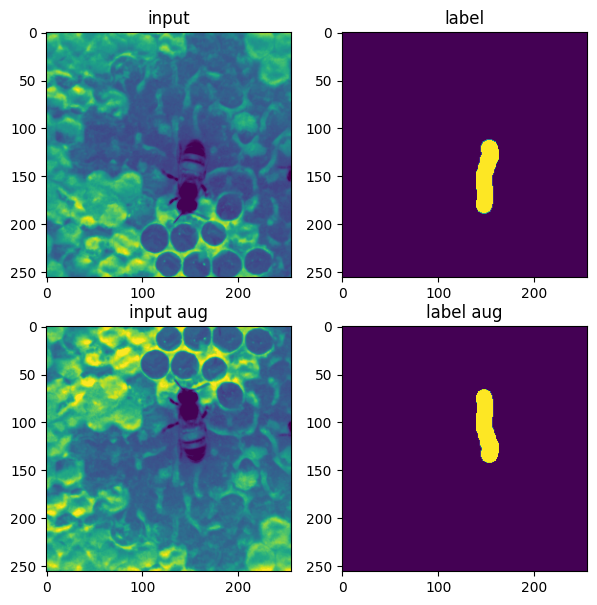

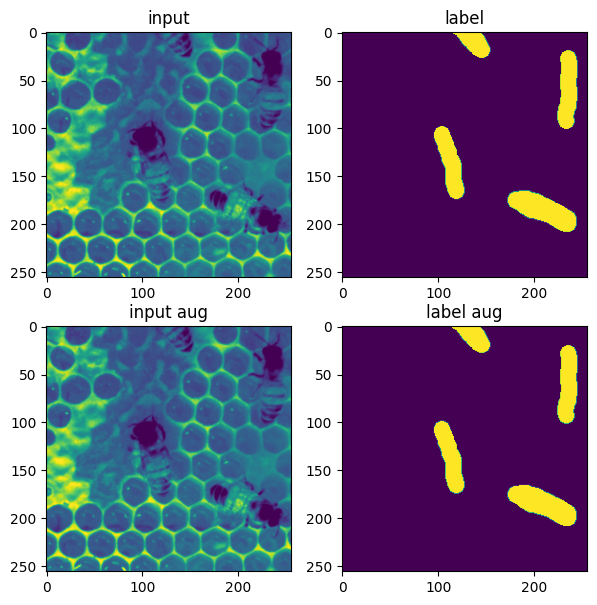

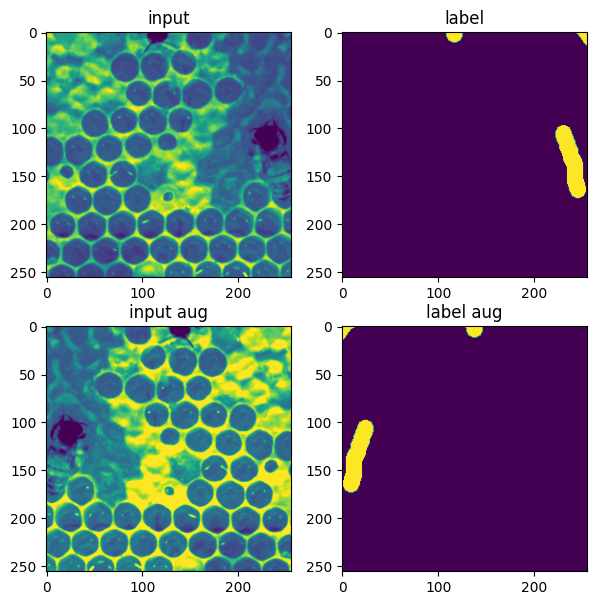

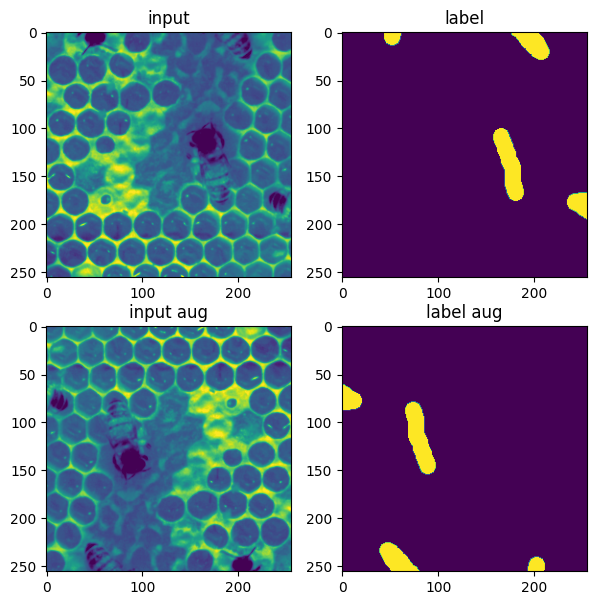

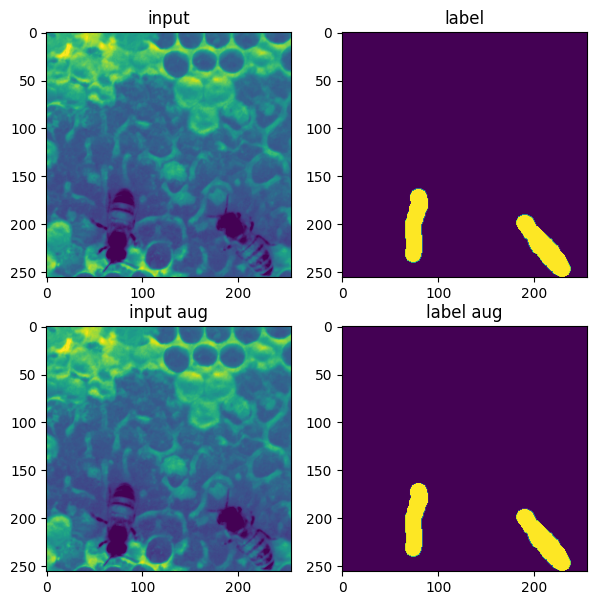

...

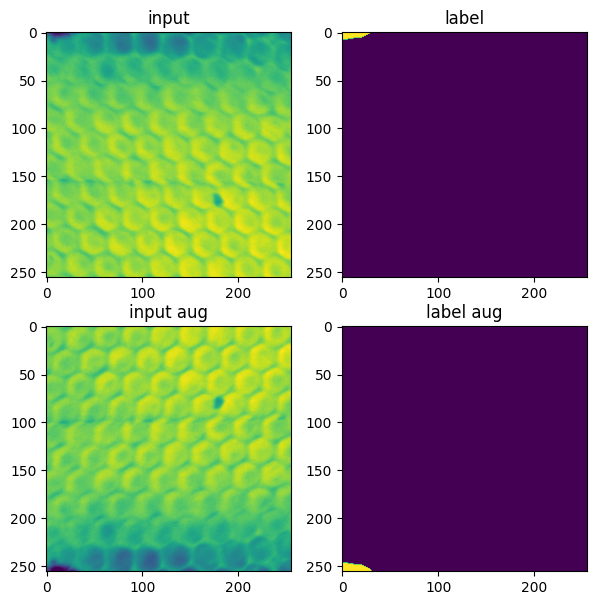

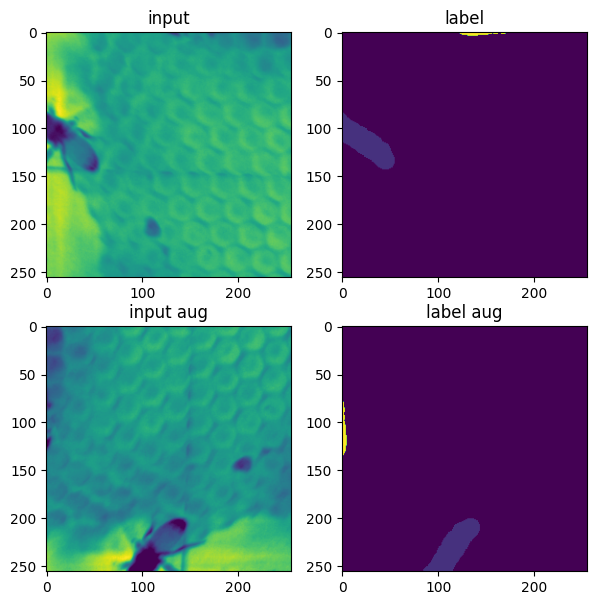

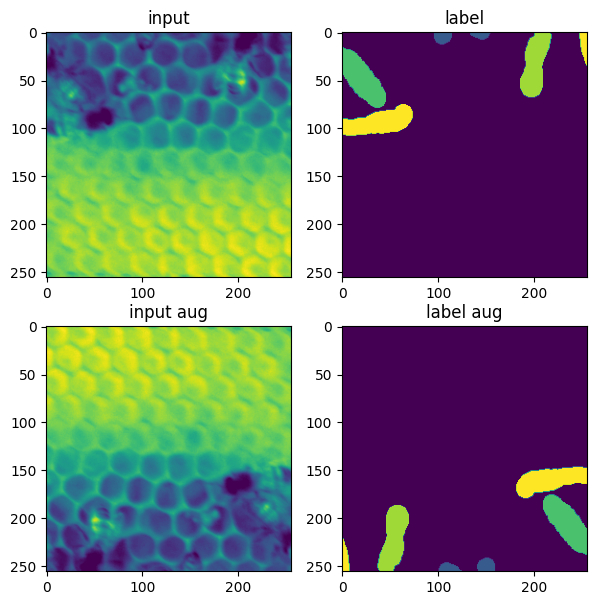

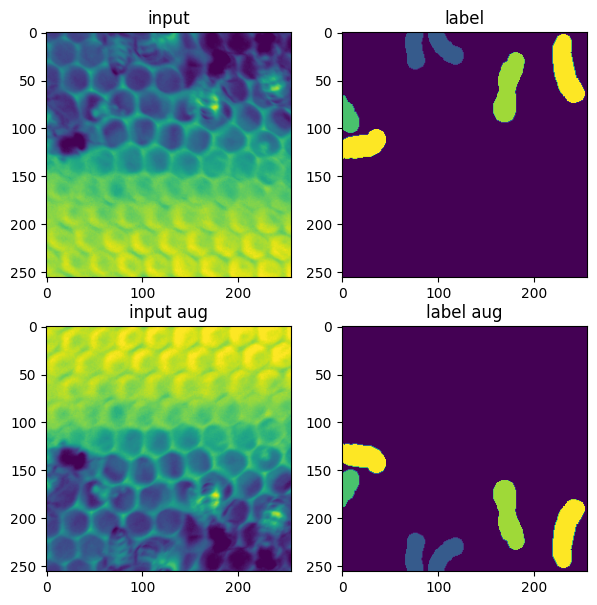

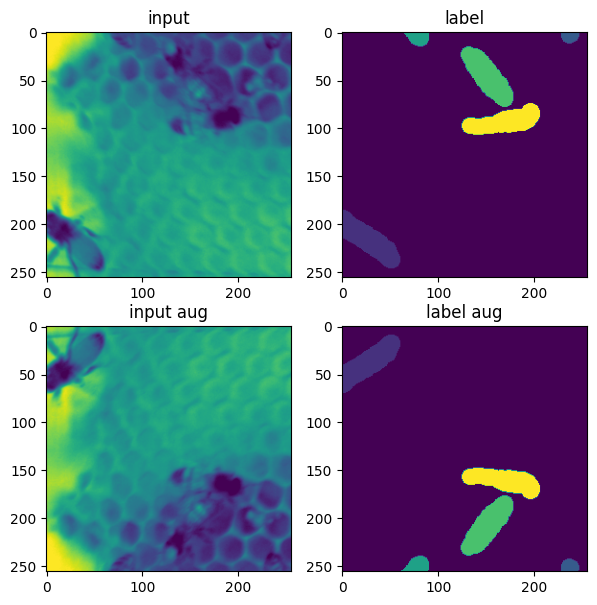

In [10]:
from random import randint
from nbdime import patch
import numpy as np



#patch_size = 448
#num_patches_per_file = 30

patch_size = 256
num_patches_per_file = 10

for file_name in files:

    patch_base_name = file_name.name
    splitter = str(patch_base_name).split('.')
    patch_base_name = splitter[0]
    ext = file_name.suffix
    #print(str(file_name))

    print(patch_base_name, ext)

    #im = imread(image_path / (patch_base_name+ext)).astype(np.float32).mean(axis=2).astype(np.float32)
    im = imread(image_path / (patch_base_name+ext)).astype(np.float32)
    labels = imread(mask_path / (patch_base_name+'.tif')).astype(np.float32)#.mean(axis=2).astype(np.float32)
    im, _, _ = quantile_normalization(im)

    for i in range(num_patches_per_file):
        x=randint(0,im.shape[1]-patch_size-1)
        y=randint(0,im.shape[0]-patch_size-1)

        ind = np.s_[y:y+patch_size, x:x+patch_size]
            
        aug = A.Compose([
            A.VerticalFlip(p=0.5),
            A.HorizontalFlip(p=0.5),              
            A.RandomRotate90(p=0.5),
            #A.RandomSizedCrop(min_max_height=(patch_size//2, patch_size), height=patch_size, width=patch_size, p=0.5),
            A.RandomBrightnessContrast(p=0.8),
            #A.RandomGamma(p=0.8),
            ]
        )

        augmented = aug(image=im[ind], mask=labels[ind])

        im_aug = augmented['image']
        label_aug = augmented['mask']

        print(im_aug.shape, label_aug.shape)

        fig = imshow_multi2d([im[ind], labels[ind], im_aug, label_aug], ['input', 'label','input aug', 'label aug'], 2,2, width=7, height=7)

        patch_base_name = 'roots'

        #image_name, patch_name = generate_patch_names(str(image_patch_path), str(label_patch_path), patch_base_name)
        #print(image_name, patch_name)
        #imsave(image_name, im[ind])
        #imsave(patch_name, labels[ind])

        image_name, patch_name = generate_patch_names(str(image_patch_path), str(label_patch_path), patch_base_name)
        print(image_name, patch_name)
        imsave(image_name, im_aug)
        imsave(patch_name, label_aug)
